<a href="https://colab.research.google.com/github/ArmandoSaboia/banking_marketing/blob/main/Bank_term_deposit_marketing_problem.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install pycaret[full] shap pycaret[analysis] catboost autoviz -U ydata-profiling dataprep sweetviz lux gradio --upgrade IPython -q streamlit dash jupyter-dash

Note: you may need to restart the kernel to use updated packages.


In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import ydata_profiling
from ydata_profiling import ProfileReport
import sys
!{sys.executable} -m pip install -U ydata-profiling[notebook]
!jupyter nbextension enable --py widgetsnbextension
from dataprep.eda import create_report
from autoviz.AutoViz_Class import AutoViz_Class
%matplotlib inline
from IPython.display import display, HTML, IFrame
import lux
import sweetviz as sv
import shap
shap.initjs()
import gradio as gr
import streamlit as st
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import roc_curve, auc
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from pycaret.classification import *
from pycaret.classification import compare_models, create_model, tune_model
from catboost import CatBoostClassifier
from sklearn.preprocessing import LabelEncoder
import os
import warnings
from sklearn.exceptions import ConvergenceWarning
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter("ignore", category=ConvergenceWarning)

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.width', None)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

/home/sasa2020/anaconda3/envs/banking_marketing/lib/python3.10/site-packages/numba/core/decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)
/home/sasa2020/anaconda3/envs/banking_marketing/lib/python3.10/site-packages/visions/backends/shared/nan_handling.py:51: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def hasna(x: np.ndarray) -> bool:


Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: OK


Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


In [ ]:
# Data loading
df = pd.read_csv('/home/sasa2020/Documentos/apps/bank_marketing/bank-full.csv', sep=";")


In [ ]:
df = df.drop(labels=['default', 'day',
             'pdays', 'previous', 'poutcome', 'poutcome'], axis=1)


In [ ]:
# Exploratory Data Analysis (EDA)
def bank_df(df):
    print("##################### Shape #####################")
    print(df.shape)
    print("##################### Types #####################")
    print(df.dtypes)
    print("##################### Head #####################")
    print(df.head(5))
    print("##################### Info #####################")
    print(df.info())
    print("##################### NA #####################")
    print(df.isnull().sum())
    print("##################### Describe #####################")
    print(df.describe())
    print("##################### Quantiles #####################")
    print(df.quantile([0, 0.05, 0.50, 0.95, 0.99, 1]).T)
    print("##################### Correlation #####################")
    print(df.corr())

bank_df(df)

##################### Shape #####################
(45211, 12)
##################### Types #####################
age           int64
job          object
marital      object
education    object
balance       int64
housing      object
loan         object
contact      object
month        object
duration      int64
campaign      int64
y            object
dtype: object
##################### Head #####################
   age      job      marital  education   balance housing loan contact  month  \
0  58     management  married   tertiary   2143      yes    no  unknown   may   
1  44     technician   single  secondary     29      yes    no  unknown   may   
2  33   entrepreneur  married  secondary      2      yes   yes  unknown   may   
3  47    blue-collar  married    unknown   1506      yes    no  unknown   may   
4  33        unknown   single    unknown      1       no    no  unknown   may   

   duration  campaign  y   
0     261        1     no  
1     151        1     no  
2      76     

In [ ]:
# Rename the column 'y' to 'term_deposit'
df.rename(columns={'y': 'term_deposit'}, inplace=True)

In [ ]:
df.describe().T.style.bar(
    subset=["mean"], color="#1c55d9"
).background_gradient(
    subset=["std"], cmap="YlOrRd"
).background_gradient(
    subset=["50%"], cmap="bwr"
)

,count,mean,std,min,25%,50%,75%,max
age,45211.000000,40.936210,10.618762,18.000000,33.000000,39.000000,48.000000,95.000000
balance,45211.000000,1362.272058,3044.765829,-8019.000000,72.000000,448.000000,1428.000000,102127.000000
duration,45211.000000,258.163080,257.527812,0.000000,103.000000,180.000000,319.000000,4918.000000
campaign,45211.000000,2.763841,3.098021,1.000000,1.000000,2.000000,3.000000,63.000000


In [ ]:
# Numerical and categorical Variables
def col_names(df, cat_th=10, car_th=20):
    categorical_cols = [col for col in df.columns if df[col].dtypes == "O"]
    numerical_but_categorical = [col for col in df.columns if df[col].nunique() < cat_th and
                   df[col].dtypes != "O"]
    categorical_but_cardinal = [col for col in df.columns if df[col].nunique() > car_th and
                   df[col].dtypes == "O"]
    categorical_cols = categorical_cols + numerical_but_categorical
    categorical_cols = [col for col in categorical_cols if col not in categorical_but_cardinal]

    # num_cols
    numerical_cols = [col for col in df.columns if df[col].dtypes != "O"]
    numerical_cols = [col for col in numerical_cols if col not in numerical_but_categorical]

    print(f"observations: {df.shape[0]}")
    print(f"variables: {df.shape[1]}")
    print(f'categorical_cols: {len(categorical_cols)}')
    print(f'numerical_cols: {len(numerical_cols)}')
    print(f'categorical_but_cardinal: {len(categorical_but_cardinal)}')
    print(f'numerical_but_categorical: {len(numerical_but_categorical)}')
    return categorical_cols, numerical_cols, categorical_but_cardinal

categorical_cols, numerical_cols, categorical_but_cardinal = col_names(df)

observations: 45211
variables: 12
categorical_cols: 8
numerical_cols: 4
categorical_but_cardinal: 0
numerical_but_categorical: 0


In [ ]:
categorical_cols

['job',
 'marital',
 'education',
 'housing',
 'loan',
 'contact',
 'month',
 'term_deposit']

In [ ]:
numerical_cols

['age', 'balance', 'duration', 'campaign']

In [ ]:
# Outliers
def outlier_limits(df, col_name, q1=0.05, q3=0.95):
    q1_val, q3_val = df[col_name].quantile([q1, q3])
    iqr = q3_val - q1_val
    return q1_val - 1.5 * iqr, q3_val + 1.5 * iqr


In [ ]:
outlier_limits(df, "age")


(-21.0, 107.0)

In [ ]:
def find_outliers(df, col_name, index=False):
    low, up = outlier_limits(df, col_name)
    outliers = df[(df[col_name] < low) | (df[col_name] > up)]

    if len(outliers) > 10:
        print(outliers.head())
    else:
        print(outliers)

    if index:
        return outliers.index


In [ ]:
find_outliers(df, "age")


Empty LuxDataFrame
Columns: [age, job, marital, education, balance, housing, loan, contact, month, duration, campaign, term_deposit]
Index: []


In [ ]:
def find_outliers(df, col_name):
    low_limit, up_limit = outlier_limits(df, col_name)
    return df[(df[col_name] > up_limit) | (df[col_name] < low_limit)].any(axis=None)


for col in numerical_cols:
    print(col, find_outliers(df, col))


age False
balance True
duration True
campaign True


In [ ]:
# Removing Outliers
def remove_outliers(df, col_name):
    low_limit, up_limit = outlier_limits(df, col_name)
    return df[~((df[col_name] < low_limit) | (df[col_name] > up_limit))]


for col in numerical_cols:
    df = remove_outliers(df, col)

for col in numerical_cols:
    print(col, find_outliers(df, col))


age False
balance True
duration True
campaign True


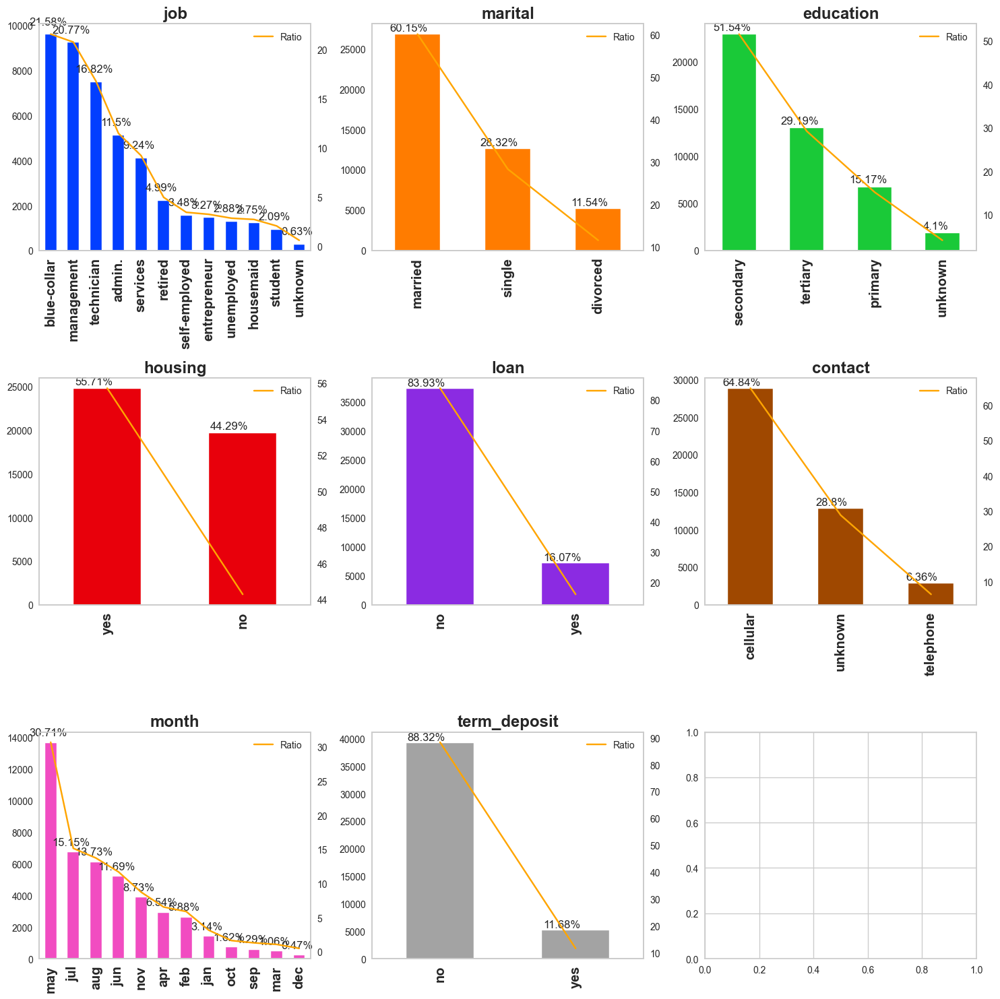

In [ ]:
def categorical_analysis(df, col_names, plot=False):
    sns.set_style("whitegrid")
    palette = sns.color_palette("bright")
    fig, axes = plt.subplots(nrows=(len(col_names)-1)//3 + 1,
                             ncols=3, figsize=(15, 5*((len(col_names)-1)//3 + 1)))

    for i, col_name in enumerate(col_names):
        value_counts = df[col_name].value_counts()
        ratio = 100 * value_counts / len(df)

        ax = axes[i//3, i % 3]
        ax2 = ax.twinx()
        value_counts.plot(kind='bar', ax=ax, color=palette[i], grid=False)
        ax.set_xticklabels(ax.get_xticklabels(), rotation=90,
                           fontsize='large', fontweight='bold')
        ax.set_title(col_name, fontsize='x-large', fontweight='bold')
        pd.DataFrame({'Ratio': ratio}, index=value_counts.index).plot(
            ax=ax2, color='orange', legend=True, grid=False)
        ax2.set_ylim(auto=True)

        for j, v in enumerate(value_counts):
            ax.text(j-0.1, v+0.01*len(df),
                    f"{round(ratio[j], 2)}%", ha='center', va='baseline')

    plt.tight_layout()
    if plot:
        plt.show(block=True)


categorical_analysis(df, categorical_cols, True)


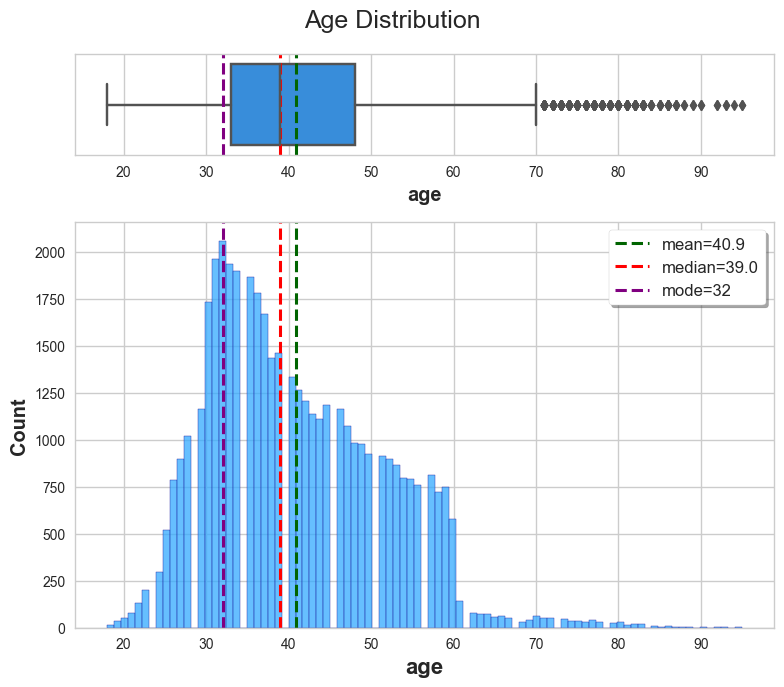

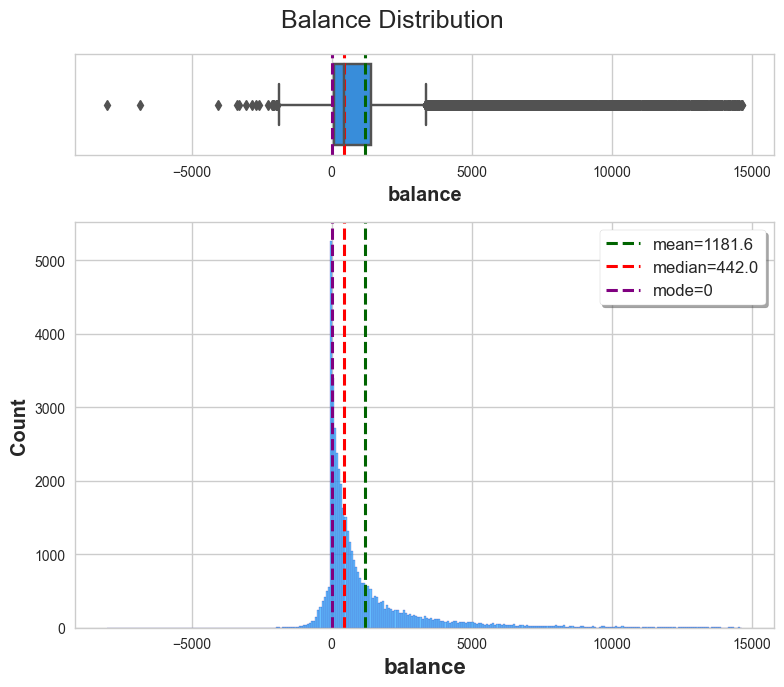

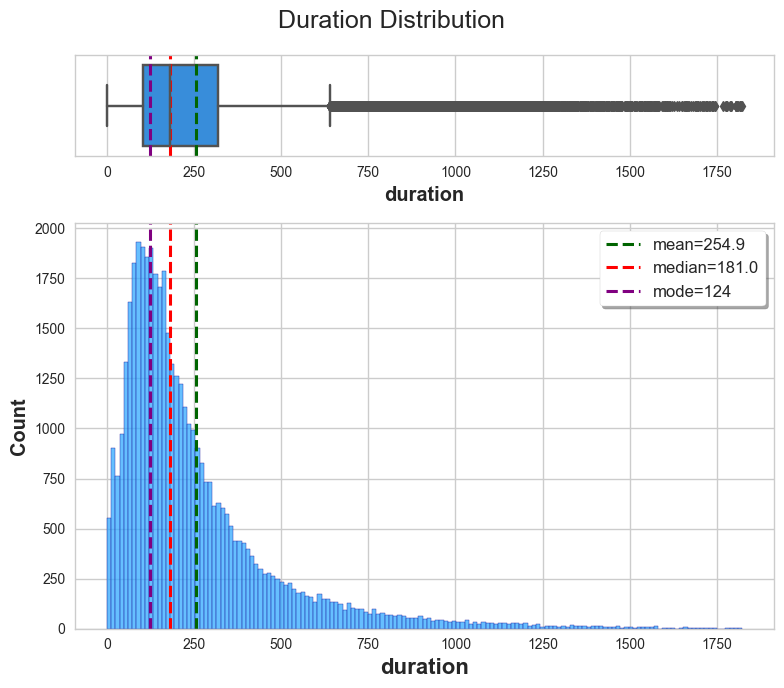

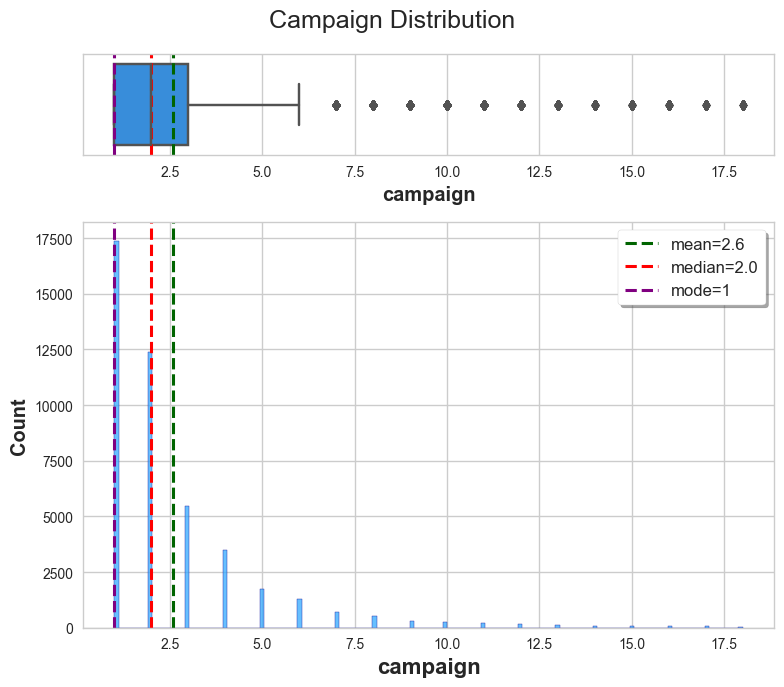

In [ ]:
# Numerical analysis
plt.style.use("seaborn-whitegrid")
plt.rc("figure", autolayout=True)
plt.rc("axes", labelweight="bold", labelsize="large", titleweight="bold", titlesize=14, titlepad=10)

# Function to generate numerical plots
def numerical_plot(df, col, title, symb):
    fig, axes = plt.subplots(2, 1, figsize=(8, 7), gridspec_kw={"height_ratios": (.2, .8)}, constrained_layout=True)
    fig.suptitle(title, fontsize=18)

    sns.boxplot(x=col, data=df, ax=axes[0], color="#1D8EF5")
    axes[0].set(yticks=[])

    sns.histplot(x=col, data=df, ax=axes[1], color="#33AAFF", edgecolor="#1D1EA2")
    axes[1].set_xlabel(col, fontsize=16)

    mean_val = df[col].mean()
    median_val = df[col].median()
    mode_val = df[col].mode()[0]

    axes[0].axvline(mean_val, color='darkgreen', linestyle='--', linewidth=2.2, label='mean=' + str(np.round(mean_val, 1)) + symb)
    axes[0].axvline(median_val, color='red', linestyle='--', linewidth=2.2, label='median=' + str(np.round(median_val, 1)) + symb)
    axes[0].axvline(mode_val, color='purple', linestyle='--', linewidth=2.2, label='mode=' + str(np.round(mode_val, 1)) + symb)
    axes[1].axvline(mean_val, color='darkgreen', linestyle='--', linewidth=2.2, label='mean=' + str(np.round(mean_val, 1)) + symb)
    axes[1].axvline(median_val, color='red', linestyle='--', linewidth=2.2, label='median=' + str(np.round(median_val, 1)) + symb)
    axes[1].axvline(mode_val, color='purple', linestyle='--', linewidth=2.2, label='mode=' + str(np.round(mode_val, 1)) + symb)
    axes[1].legend(loc='upper right', fontsize=12, fancybox=True, shadow=True, frameon=True)

    plt.tight_layout()
    plt.show()

# Loop over each numerical column and generate plots
for col in numerical_cols:
    numerical_plot(df, col, f'{col.capitalize()} Distribution', '')

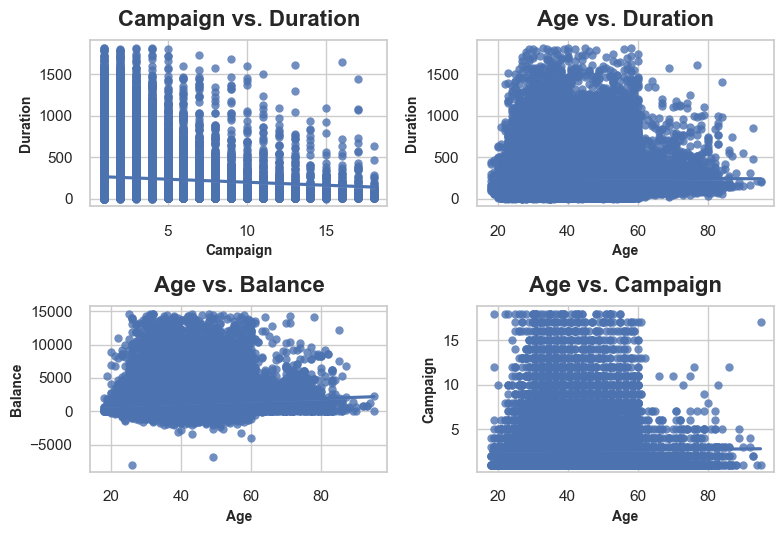

In [ ]:
# Using Seaborn regplot
sns.set(style='whitegrid')

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2)

# First regplot
sns.regplot(x='campaign', y='duration', data=df, ax=ax1)
ax1.set_xlabel('Campaign', fontsize=10)
ax1.set_ylabel('Duration',fontsize=10)
ax1.set_title('Campaign vs. Duration',fontsize=16)

# Second regplot
sns.regplot(x='age', y='duration', data=df, ax=ax2)
ax2.set_xlabel('Age', fontsize=10)
ax2.set_ylabel('Duration',fontsize=10)
ax2.set_title('Age vs. Duration',fontsize=16)

# Third regplot
sns.regplot(x='age', y='balance', data=df, ax=ax3)
ax3.set_xlabel('Age', fontsize=10)
ax3.set_ylabel('Balance',fontsize=10)
ax3.set_title('Age vs. Balance',fontsize=16)

# Fourth regplot
sns.regplot(x='age', y='campaign', data=df, ax=ax4)
ax4.set_xlabel('Age', fontsize=10)
ax4.set_ylabel('Campaign',fontsize=10)
ax4.set_title('Age vs. Campaign',fontsize=16)

plt.tight_layout()

In [ ]:
df["age_groups"] = pd.cut(df['age'], bins=[0, 20, 30, 40, 50, 60, float('Inf')], labels=['0-20', '20-30', '30-40', '40-50', '50-60', '60-100'])

In [3]:
palette = {'yes':'blue', 'no':'red'}
palette = {'yes':'#0057e7', 'no':'#d62d20'}

plt.figure(figsize=(10,6))
sns.boxplot(x='age_groups', y='balance', hue='term_deposit', data=df, palette=palette)
plt.ylabel('balance($) log transform.')
plt.xlabel('Age')
plt.title('Balance VS Age by Term Deposit')
plt.yscale('log')
plt.legend(bbox_to_anchor=(1.2, 1.0), title='Success', fontsize=12, fancybox=True, shadow=True, frameon=True)
plt.show()

NameError: ignored

In [4]:
palette = {'yes':'blue', 'no':'red'}
palette = {'yes':'#0057e7', 'no':'#d62d20'}

plt.figure(figsize=(10,6))
sns.boxplot(x='age_groups', y='duration', hue='term_deposit', data=df, palette=palette)
plt.ylabel('balance($) log transform.')
plt.xlabel('Age')
plt.title('Balance VS Age by Term Deposit')
plt.yscale('log')
plt.legend(bbox_to_anchor=(1.2, 1.0), title='Success', fontsize=12, fancybox=True, shadow=True, frameon=True)
plt.show()

NameError: ignored

In [ ]:
df = df.drop('age_groups', axis=1)


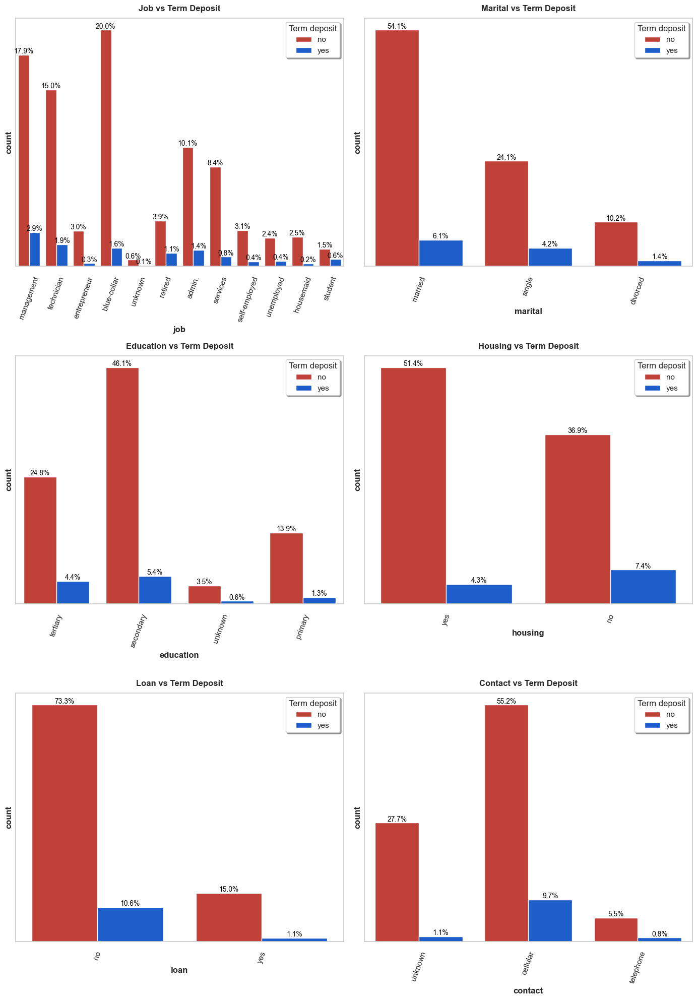

In [ ]:
# Define the palette for the countplots
palette = ['#d62d20', '#0057e7']

# List of categorical columns
categorical_cols = ['job', 'marital', 'education', 'housing', 'loan', 'contact']

# Set up the grid layout
fig, axes = plt.subplots(3, 2, figsize=(14, 20))
fig.tight_layout(pad=4.0)

# Generate countplots for each categorical column
for i, col in enumerate(categorical_cols):
    row = i // 2  # Calculate the row index
    col = i % 2  # Calculate the column index

    ax = axes[row, col]  # Get the corresponding subplot

    ax.set_title(f'{categorical_cols[i].capitalize()} vs Term Deposit')
    sns.countplot(x=categorical_cols[i], hue='term_deposit', data=df, palette=palette, ax=ax)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=70)
    ax.set_yticks([])
    ax.legend(loc='upper right', title='Term deposit', ncol=1, fancybox=True, shadow=True, frameon=True)

    # Add count numbers and percentage values to the bars
    for p in ax.patches:
        # Calculate the percentage of each category in the dataset
        pcnt = '{:.1f}%'.format(100 * p.get_height()/len(df))
        ax.annotate(pcnt, xy=(p.get_x() + p.get_width()/2, p.get_height()),
                    xytext=(0, 2), textcoords='offset points', ha='center', color='black', fontsize=10)

plt.show()

In [ ]:
# Compute the correlation matrix
corr = df[numerical_cols].corr()
corr

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

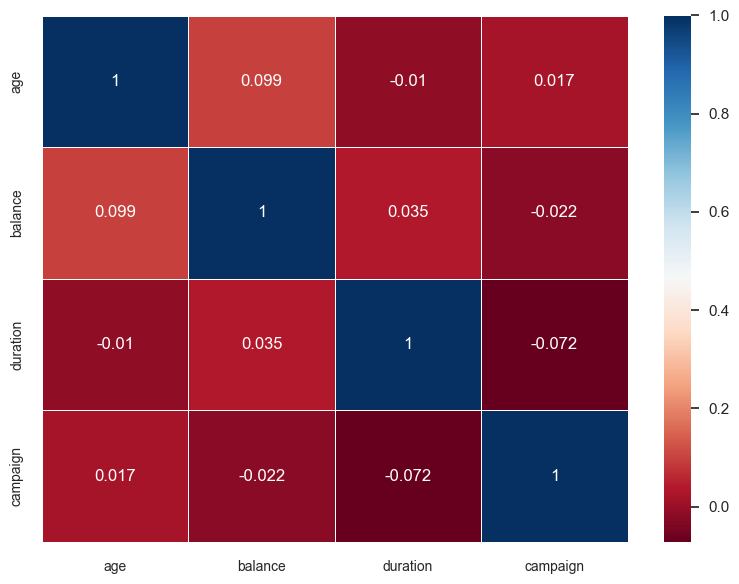

In [ ]:
def correlation_matrix(df, cols):
     fig = plt.gcf()
     fig.set_size_inches(8, 6)
     plt.xticks(fontsize=10)
     plt.yticks(fontsize=10)
     fig = sns.heatmap(df[cols].corr(), annot=True, linewidths=0.5, annot_kws={'size': 12}, linecolor='w', cmap='RdBu')
     plt.show(block=True)

correlation_matrix(df, numerical_cols)

In [ ]:
# Modelling

# Drop the Job Categories that are "Unknown"
df = df.drop(df.loc[df["job"] == "unknown"].index)
df = df.drop(df.loc[df["education"] == "unknown"].index)


# Manager and admin are the same and under the same categorical value
lst = [df]

for col in lst:
    col.loc[col["job"] == "admin.", "job"] = "management"


In [ ]:
categorical_cols, numerical_cols, categorical_but_cardinal = col_names(
    df, cat_th=5, car_th=20)


observations: 42444
variables: 12
categorical_cols: 8
numerical_cols: 4
categorical_but_cardinal: 0
numerical_but_categorical: 0


In [ ]:
categorical_cols


['job',
 'marital',
 'education',
 'housing',
 'loan',
 'contact',
 'month',
 'term_deposit']

In [ ]:
numerical_cols


['age', 'balance', 'duration', 'campaign']

In [ ]:
# AutoViz
exp_name = setup(data = df,  target = 'term_deposit')
eda(display_format = 'bokeh')

,Description,Value
0,Session id,1974
1,Target,term_deposit
2,Target type,Binary
3,Target mapping,"no: 0, yes: 1"
4,Original data shape,"(42444, 12)"
5,Transformed data shape,"(42444, 38)"
6,Transformed train set shape,"(29710, 38)"
7,Transformed test set shape,"(12734, 38)"
8,Ordinal features,2
9,Numeric features,4


Shape of your Data Set loaded: (42444, 38)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    37 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Binary_Classification problem #####################
Number of variables = 37 exceeds limit, finding top 30 variables through XGBoost
    No categorical feature reduction done. All 33 Categorical vars selected 
    Removing correlated variables from 4 numerics using SULO method
Selecting all (4) variables since none of them are highly correlated...
    Adding 33 categorical variables to reduced numeric variables  of 4
############## F E A T U R E   S E L E C T I O N  ####################
Current number of predicto

Row
    [0] WidgetBox
        [0] Select(name='y', options=['duration'], value='duration')
    [1] ParamFunction(function, _pane=HoloViews)

Column
    [0] Row
        [0] HoloViews(DynamicMap, height=400, sizing_mode='fixed', width=600)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['contact_unknown', ...], value='contact_unknown', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap, height=400, sizing_mode='fixed', width=600)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['duration'], value='duration', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['contact_unknown', ...], value='contact_unknown')
        [1] Select(name='Y-Axis', options=['duration'], value='duration')
    [1] ParamFunction(function, _pane=HoloViews)

Time to run AutoViz (in seconds) = 30


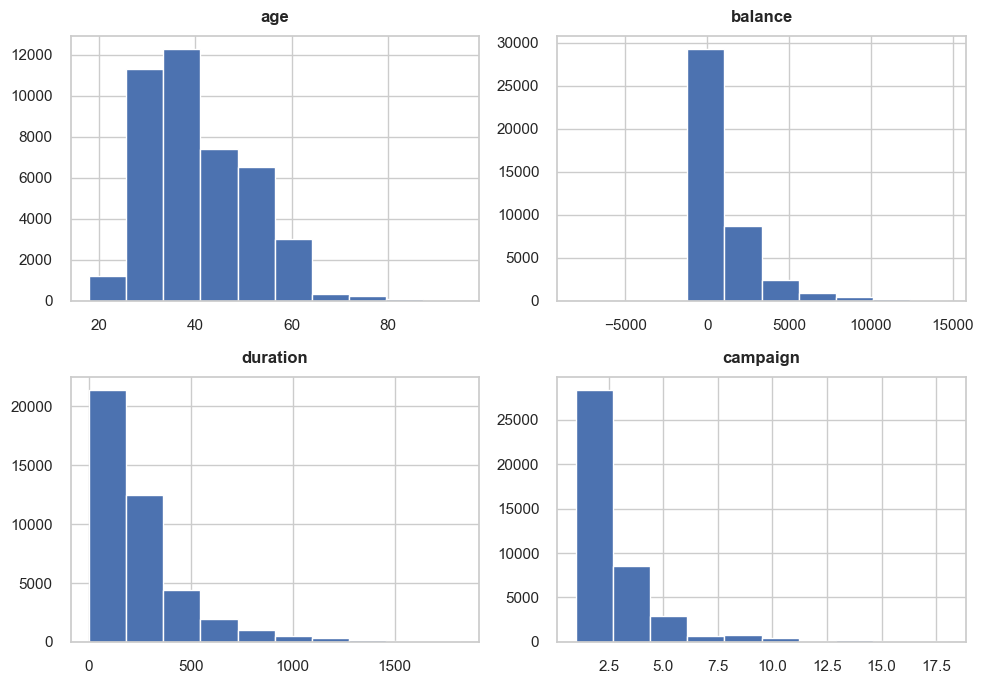

In [ ]:
# Check distributions of numerical variables
df.hist(figsize=(10, 7))
plt.tight_layout()
plt.show()

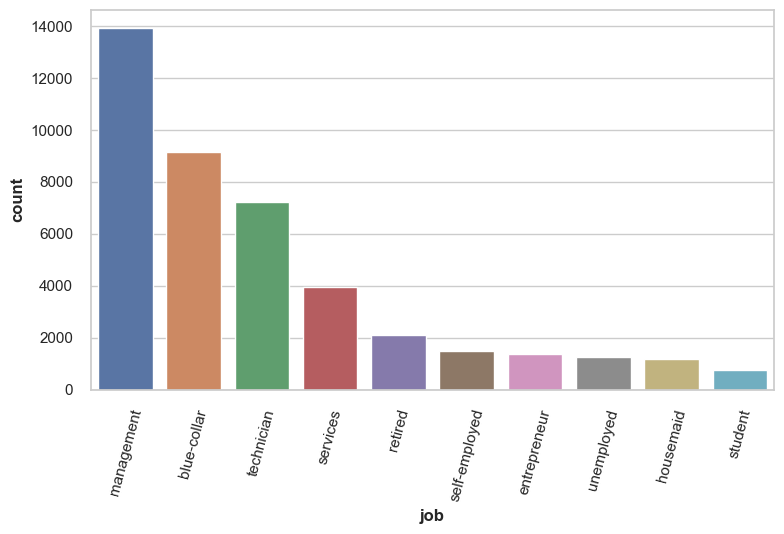

In [ ]:
# Check distributions of categorical variables# Check distributions of categorical variables
job_counts = df['job'].value_counts().sort_values(ascending=False)
sns.countplot(x='job', data=df, order=job_counts.index)
plt.xticks(rotation=75)
plt.show()

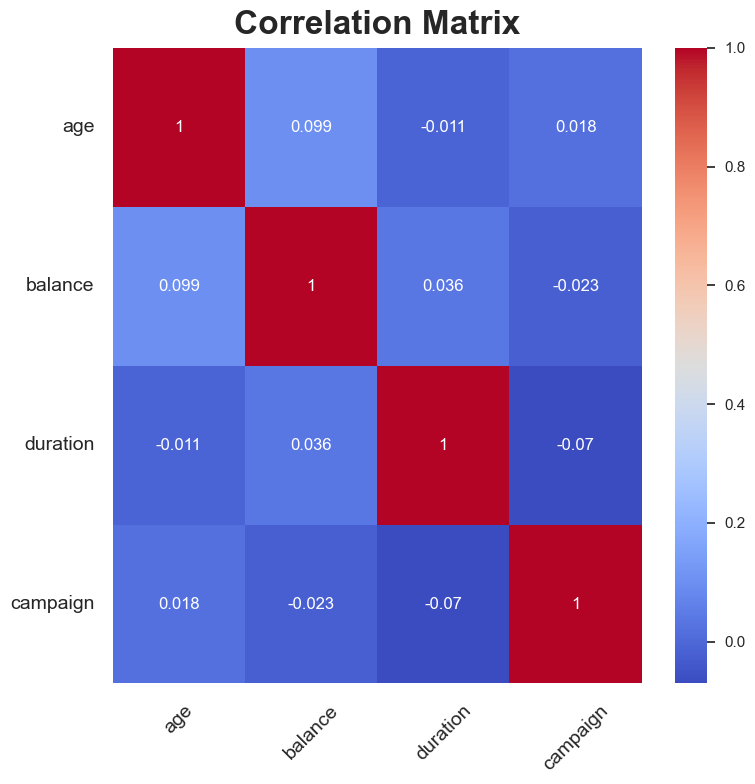

In [ ]:
# Check correlations between variables
fig, ax = plt.subplots(figsize=(8, 8))
correlation_matrix = df.corr()  # Compute the correlation matrix
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', ax=ax, annot_kws={"size": 12})  # Plot a heatmap of the correlation matrix
plt.xticks(fontsize=14, rotation=45)
plt.yticks(fontsize=14, rotation=0)
plt.title('Correlation Matrix', fontsize=24)
plt.show()

In [ ]:
# ydata-profiling report of each variable
# Produce and save the profiling report
profile = ProfileReport(df, title="Report")
profile.to_widgets()
profile.to_notebook_iframe()
#profile.to_file("report.html")

# Define the path to the PDF file
#pdf = 'report.pdf'  # Replace with the actual file path

# Display the PDF in a browser
#IFrame(pdf, width=800, height=600)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

Output()

Output()

Output()

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1519 [00:00<?, ?it/s]

DataPrep Report
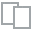
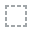
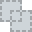
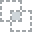
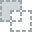
...
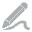
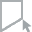
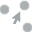
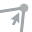
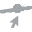

In [ ]:
# DataPrep report
create_report(df)

                                             |          | [  0%]   00:00 -> (? left)


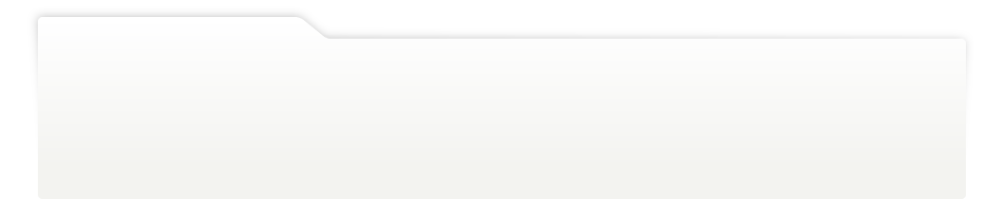
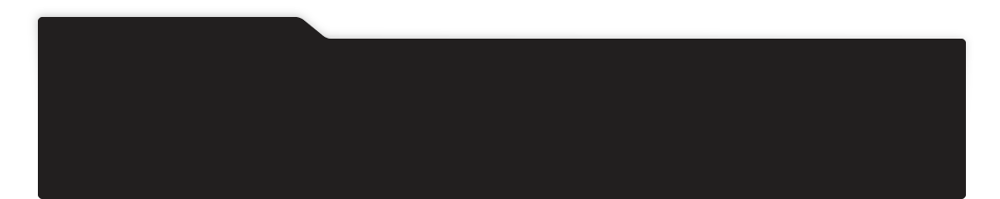
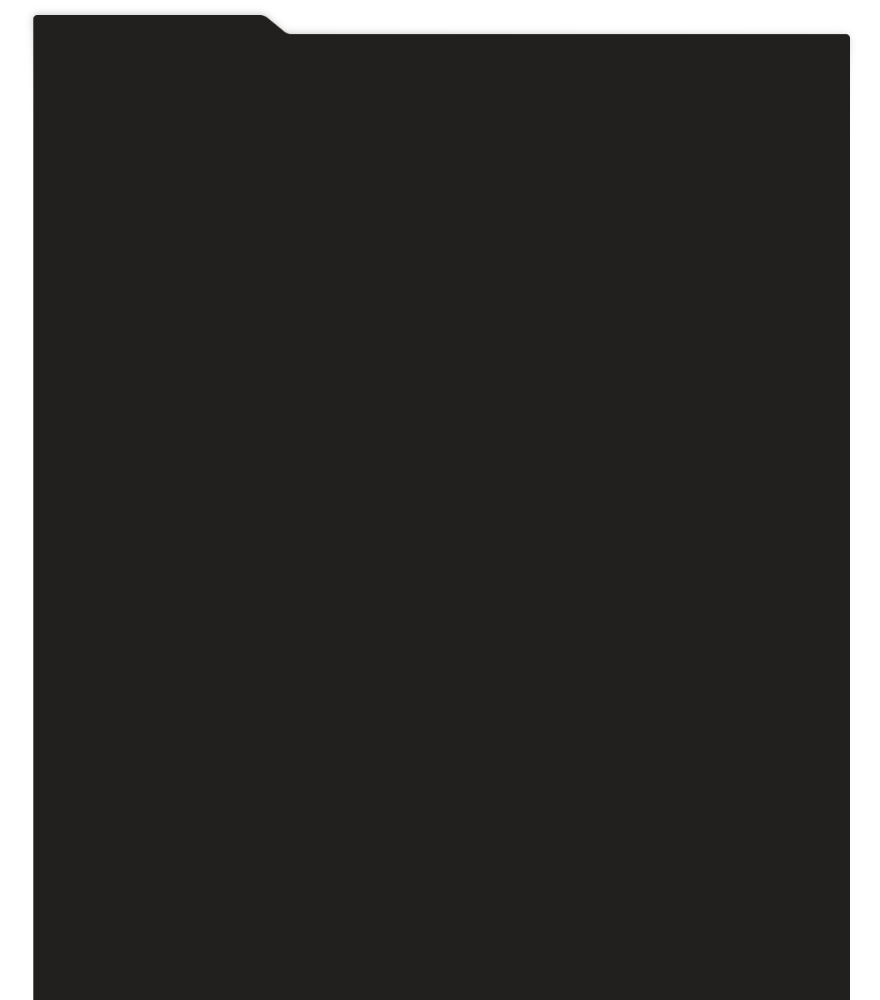
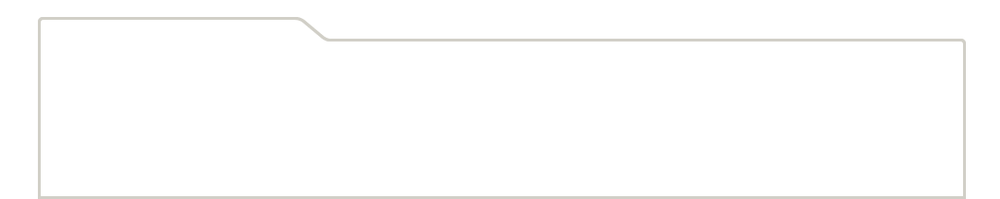
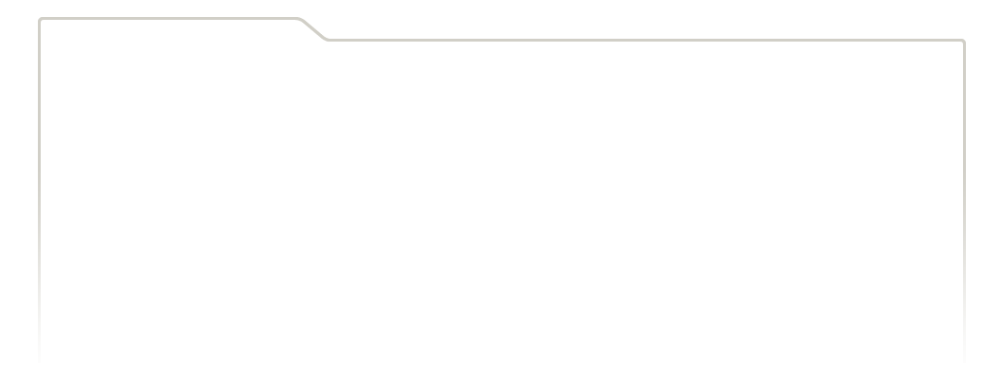
...
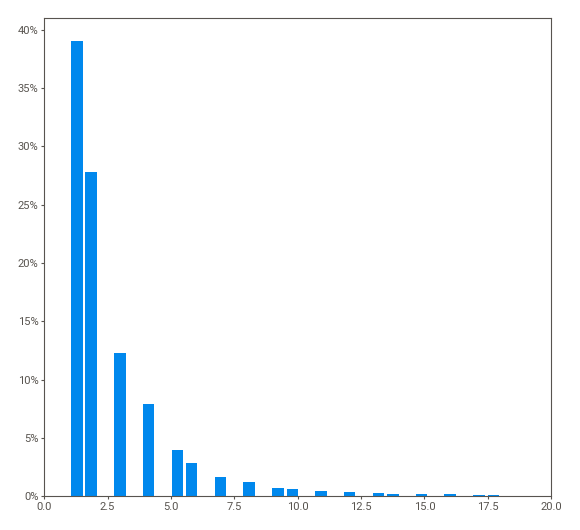
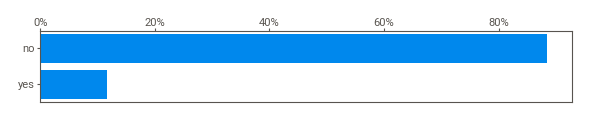
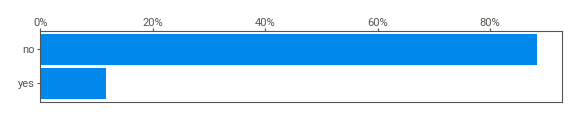
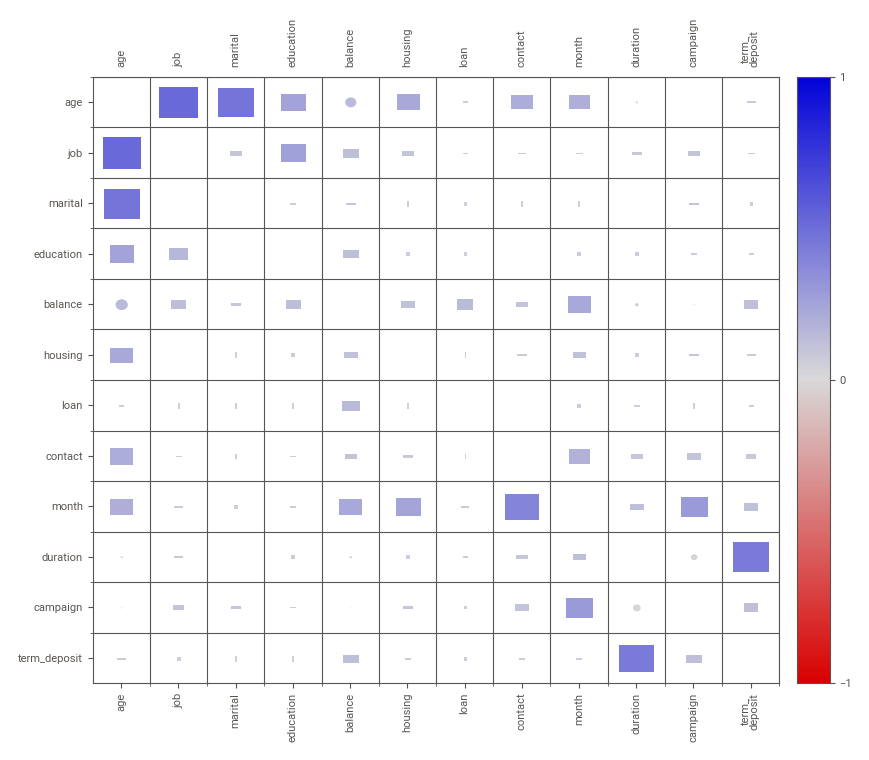
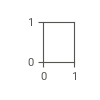

In [ ]:
# SweetViz visualizations and summarizing important feature statistics
# Produce and save the profiling report
report = sv.analyze(df)
#report.show_html('report.html')
report.show_notebook()

In [ ]:
# Encoding the categorical variables into numerical label

df['job'].unique()

le = LabelEncoder()
df['job']=le.fit_transform(df['job'])
df['marital']=le.fit_transform(df['marital'])
df['education']=le.fit_transform(df['education'])
df['housing']=le.fit_transform(df['housing'])
df['loan']=le.fit_transform(df['loan'])
df['contact']=le.fit_transform(df['contact'])
df['month']=le.fit_transform(df['month'])
df['term_deposit']=le.fit_transform(df['term_deposit'])


In [ ]:
df


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

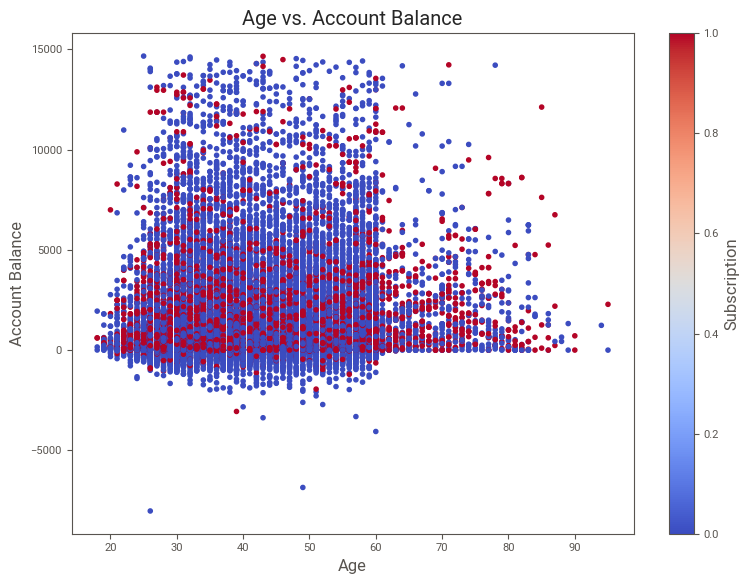

In [ ]:
plt.figure(figsize=(8, 6))
plt.scatter(df['age'], df['balance'], c=df['term_deposit'], cmap='coolwarm')
plt.xlabel('Age')
plt.ylabel('Account Balance')
plt.title('Age vs. Account Balance')
plt.colorbar(label='Subscription')
plt.show()


In [ ]:
fig = go.Figure(data=[go.Scatter3d(
    x=df['age'],
    y=df['balance'],
    z=df['duration'],
    mode='markers',
    marker=dict(
        color=df['term_deposit'],
        colorscale='Viridis',
        opacity=0.8
    )
)])
fig.update_layout(
    scene=dict(
        xaxis_title='Age',
        yaxis_title='Account Balance',
        zaxis_title='Duration'
    ),
    title='Customer Segmentation in 3D'
)
fig.show()


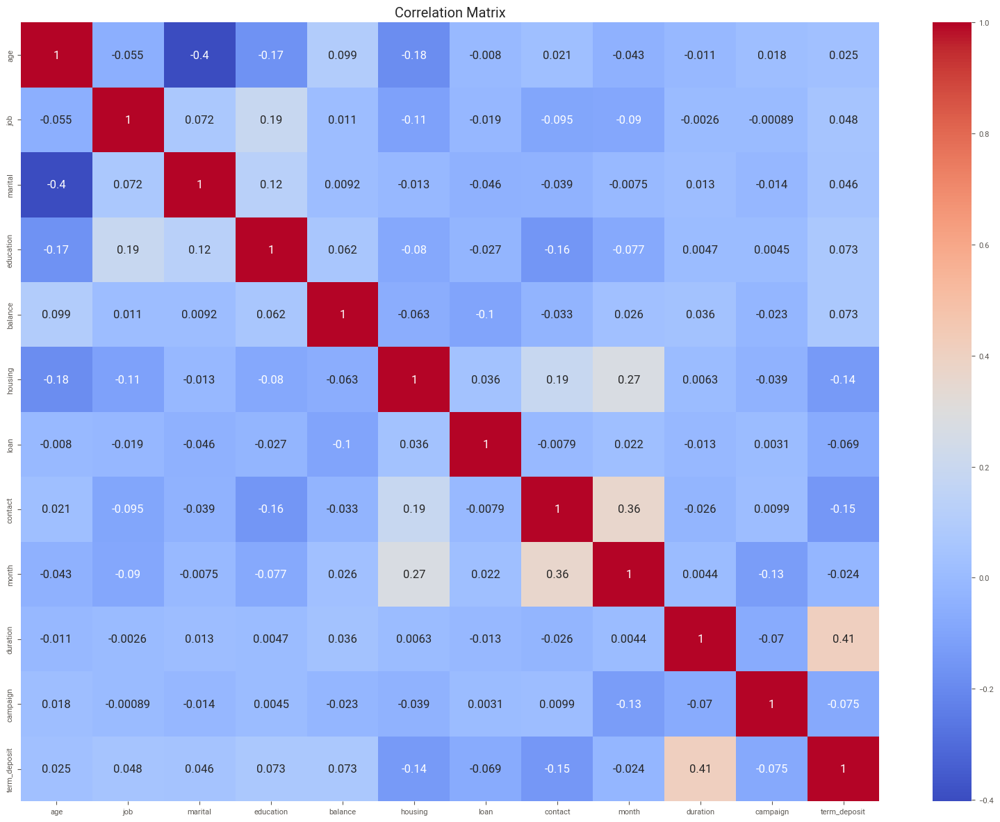

In [ ]:
correlation_matrix = df.corr()
plt.figure(figsize=(16, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


In [ ]:
# Convert categorical variables into a numerical representation
# def ohe(df, categorical_cols, drop_first=False):
#    return pd.get_dummies(df, columns=categorical_cols, drop_first=drop_first)


# df = ohe(df, categorical_cols, drop_first=True)


In [ ]:
# Train-Test Split
X = df.drop('term_deposit', axis=1)
y = df['term_deposit']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Model Training and Evaluation with PyCaret
# Initialize PyCaret setup
clf = setup(data=df, target='term_deposit', train_size=0.8)


,Description,Value
0,Session id,559
1,Target,term_deposit
2,Target type,Binary
3,Original data shape,"(42444, 12)"
4,Transformed data shape,"(42444, 12)"
5,Transformed train set shape,"(33955, 12)"
6,Transformed test set shape,"(8489, 12)"
7,Numeric features,11
8,Preprocess,True
9,Imputation type,simple


In [ ]:
# Select the best-performing model based on desired metric
# Compare multiple models using PyCaret
best_model = compare_models(sort='Accuracy')

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Processing:   0%|          | 0/69 [00:00<?, ?it/s]

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
# Best model
print(best_model)

In [ ]:
# Evaluate model performance
evaluate_model(best_model)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

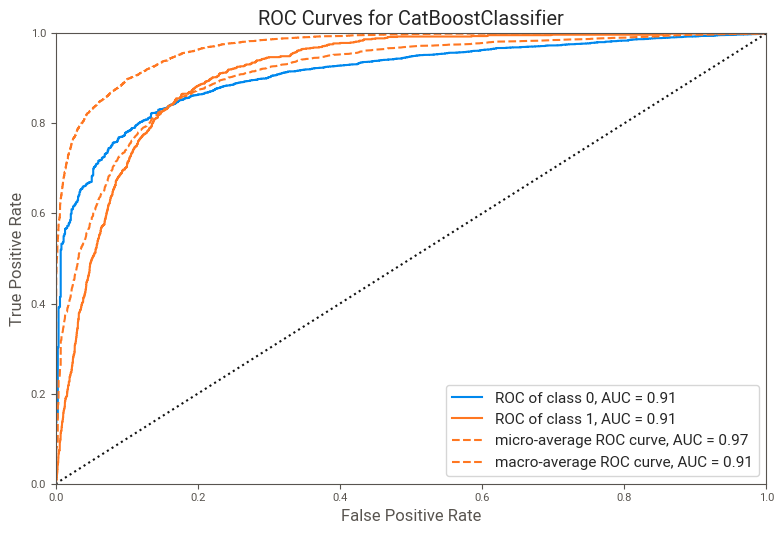

In [ ]:
plot_model(best_model)


In [ ]:
# This function scores the data and returns prediction_label and prediction_score probability of the predicted class). When data is None, it predicts label and score on the test set (created during the setup function).
predict_model(best_model)


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.8988,0.9112,0.3801,0.6003,0.4655,0.4127,0.4259


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
# Tune the best model
tuned_model = tune_model(best_model)


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9022,0.9144,0.4315,0.6115,0.5060,0.4535,0.4620
1,0.9011,0.9142,0.4315,0.6028,0.5030,0.4497,0.4575
2,0.9014,0.9189,0.3858,0.6204,0.4757,0.4245,0.4392
3,0.9028,0.9189,0.3934,0.6301,0.4844,0.4339,0.4486
4,0.8981,0.9083,0.3528,0.6043,0.4455,0.3937,0.4110
5,0.9054,0.9231,0.4402,0.6314,0.5187,0.4682,0.4775
6,0.9010,0.9119,0.4071,0.6084,0.4878,0.4354,0.4462
7,0.8999,0.9080,0.4061,0.6015,0.4848,0.4317,0.4419
8,0.9078,0.9232,0.4442,0.6506,0.5279,0.4788,0.4895


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [ ]:
# Evaluate model performance
evaluate_model(tuned_model)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

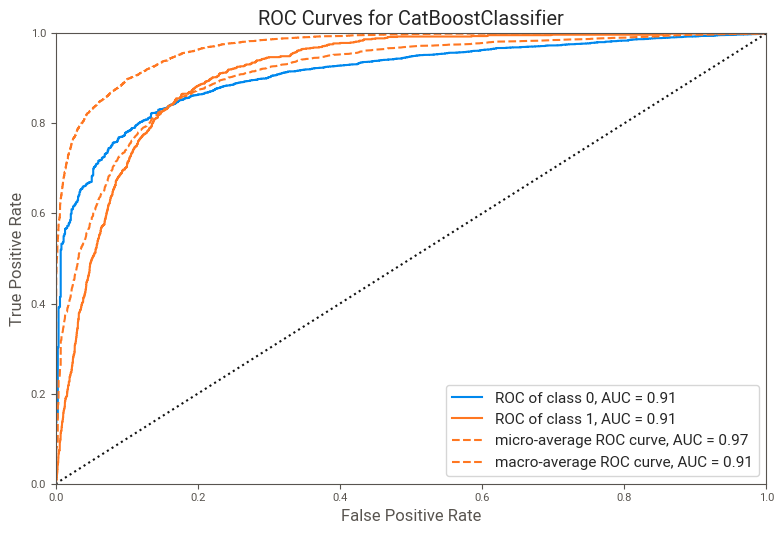

In [ ]:
plot_model(tuned_model)


In [ ]:
# This function scores the data and returns prediction_label and prediction_score probability of the predicted class). When data is None, it predicts label and score on the test set (created during the setup function).
predict_model(tuned_model)


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.8988,0.9112,0.3801,0.6003,0.4655,0.4127,0.4259


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
# The evaluation metrics are calculated on the test set. The second output is the pd.DataFrame with predictions on the test set (see the last two columns).
# To generate labels on the unseen (new) dataset, simply pass the dataset in the data parameter under predict_model function.
# Score means the probability of the predicted class (NOT the positive class). If prediction_label is 0 and prediction_score is 0.90, this means 90% probability of class 0.
predictions = predict_model(best_model, data=df)
predictions.head()


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.9297,0.9448,0.5291,0.7966,0.6358,0.5987,0.6140


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
# Showing the probability of both the classes
predictions = predict_model(best_model, data=df, raw_score=True)
predictions.head()


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,CatBoost Classifier,0.9297,0.9448,0.5291,0.7966,0.6358,0.5987,0.6140


Button(description='Toggle Pandas/Lux', layout=Layout(top='5px', width='140px'), style=ButtonStyle())

Output()

In [ ]:
# Model Interpretability with SHAP
# Calculate SHAP values
explainer = shap.Explainer(best_model)
shap_values = explainer.shap_values(X_test)


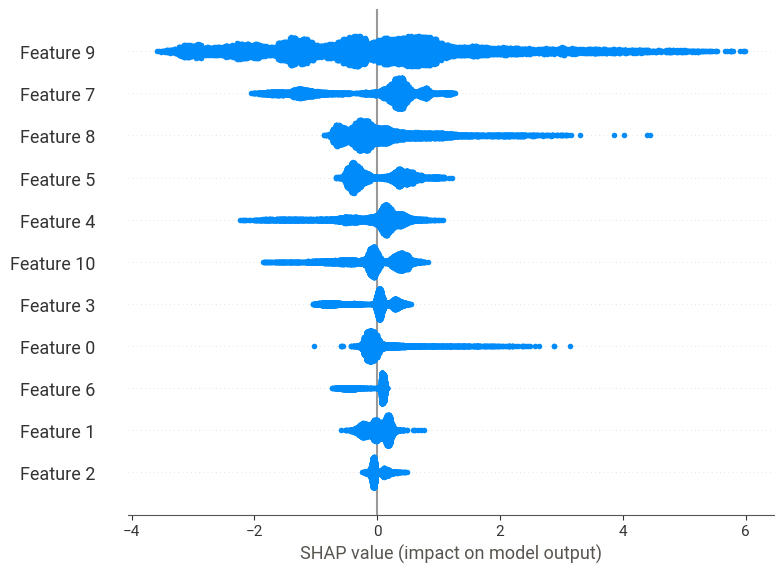

In [ ]:
# Summary Plot
shap.summary_plot(shap_values)


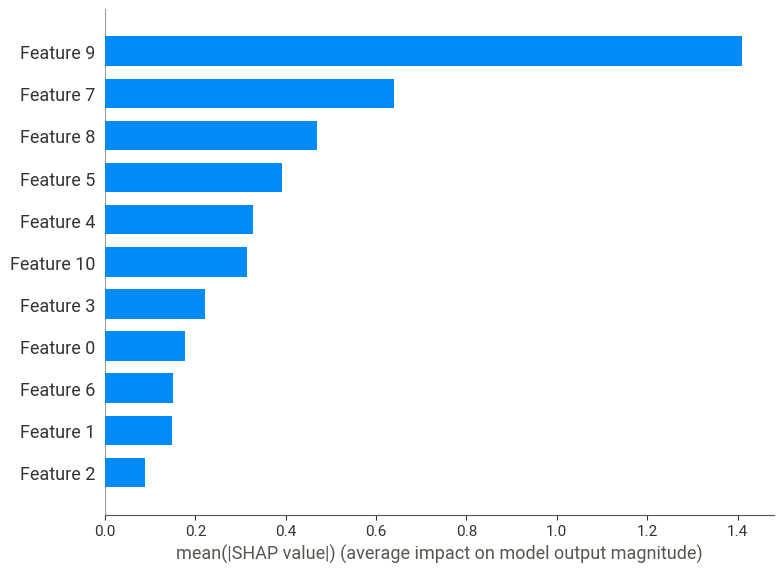

In [ ]:

# Summary Bar Plot
shap.summary_plot(shap_values, X_test, plot_type='bar')


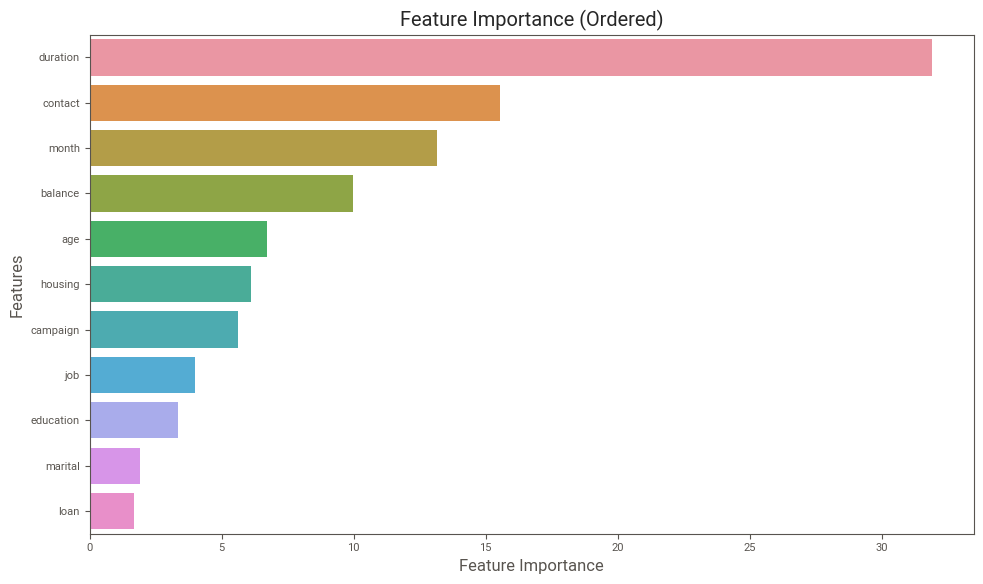

In [ ]:
# Display feature importance
feature_importance = best_model.feature_importances_
feature_names = X_train.columns

# Sort feature importance in descending order
sorted_indices = feature_importance.argsort()[::-1]
sorted_importance = feature_importance[sorted_indices]
sorted_feature_names = feature_names[sorted_indices]

plt.figure(figsize=(10, 6))
sns.barplot(x=sorted_importance, y=sorted_feature_names)
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance (Ordered)')
plt.show()


In [ ]:
# Create interactive visualizations with Plotly
fig = px.scatter(df, x='age', y='balance', color='term_deposit')
fig.update_layout(title='Age vs. Balance',
                  xaxis_title='Age', yaxis_title='Balance')
fig.show()


In [ ]:
marital_counts = df['marital'].value_counts().reset_index()
marital_counts.columns = ['Marital Status', 'Count']

fig = px.pie(marital_counts, values='Count', names='Marital Status',
             title='Marital Status Distribution')
fig.show()


In [ ]:
# Compute correlation matrix
corr_matrix = df.corr()

# Create heatmap
fig = px.imshow(corr_matrix.values,
                x=corr_matrix.columns,
                y=corr_matrix.columns,
                labels=dict(color="Correlation"),
                color_continuous_scale='RdBu',
                zmin=-1,
                zmax=1)

# Customize layout
fig.update_layout(title="Correlation Matrix Heatmap")

# Show the heatmap
fig.show()


In [ ]:
fig = px.histogram(df, x='age', nbins=30, title='Age Distribution')
fig.show()


NameError: name 'px' is not defined

In [ ]:
fig = px.box(df, x='contact', y='duration', color='month',
             labels={'contact': 'Contact',
                     'duration': 'Duration', 'month': 'Month'},
             title='Duration Distribution by Contact and Month',
             color_discrete_sequence=px.colors.qualitative.Set3)

fig.show()


NameError: name 'px' is not defined

In [ ]:
# Select a random index for individual predictions
import random

# Get the number of samples in your dataset
num_samples = len(df)

# Generate a random index
random_index = random.randint(0, num_samples - 1)

# Display the selected index
print("Selected index:", random_index)

# Perform individual prediction using the selected index
prediction = model.predict(df.iloc[random_index])

# Show the prediction result
print("Prediction:", prediction)


NameError: name 'df' is not defined

In [ ]:
# Calculate the feature contributions for a specific instance
import shap

# Create a SHAP explainer
explainer = shap.Explainer(model)

# Select a random index
random_index = random.randint(0, num_samples - 1)

# Calculate the feature contributions for the selected index
shap_values = explainer.shap_values(df.iloc[random_index])

# Plot the contributions
shap.summary_plot(shap_values, df.iloc[random_index])


NameError: name 'model' is not defined

In [1]:
# Train the best model on the full dataset
final_model = finalize_model(best_model)


NameError: ignored

In [2]:
import pickle

# Save the model to a file
pickle.dump(final_model, open('term_deposit_pipeline.pkl', 'wb'))


NameError: ignored

In [ ]:
dashboard(best_model, 'external')

Note: model_output=='probability'. For CatBoostClassifier shap values normally get calculated against X_background, but paramater X_background=None, so using X instead
Generating self.shap_explainer = shap.TreeExplainer(model, X, model_output='probability', feature_perturbation='interventional')...
Note: Shap interaction values will not be available. If shap values in probability space are not necessary you can pass model_output='logodds' to get shap values in logodds without the need for a background dataset and also working shap interaction values...
Building ExplainerDashboard..
For this type of model and model_output interactions don't work, so setting shap_interaction=False...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...


100%|===================| 8487/8489 [09:10<00:00]        

Calculating prediction probabilities...
Calculating metrics...
Calculating confusion matrices...
Calculating classification_dfs...
Calculating roc auc curves...
Calculating pr auc curves...
Calculating liftcurve_dfs...
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating predictions...
Calculating pred_percentiles...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Starting ExplainerDashboard on http://192.168.0.14:8050
You can terminate the dashboard with ExplainerDashboard.terminate(8050)


Dash app running on http://127.0.0.1:8050/


In [ ]:
# Deploy web application(streamlit)
%% writefile bank_marketing.py


UsageError: Line magic function `%%` not found.


In [ ]:
import streamlit as st
import pandas as pd
import pickle

# Load the model from a file
pickled_model = pickle.load(open(
    '/home/sasa2020/Documentos/apps/bank_marketing/term_deposit_pipeline.pkl', 'rb'))


# Load the dataset
data = pd.read_csv(
    '/home/sasa2020/Documentos/apps/bank_marketing/bank-full.csv', sep=";")

# Function to preprocess the input data


def preprocess_input(data):
    # Preprocess the data here
    processed_data = data
    return processed_data

# Function to make predictions


def term_deposit(data):
    # Make predictions using the model
    predictions = pickled_model.term_deposit(data)
    return predictions

# Streamlit app code


def main():
    # Set app title
    st.title('Bank Marketing Term Deposit Prediction App')

    # Add sidebar section for input
    st.sidebar.header('Input Parameters')

    # Add input fields for user interaction
    age = st.sidebar.number_input(
        'Age', min_value=18, max_value=100, value=30, step=1)
    job = st.sidebar.selectbox('Job', ['admin.', 'blue-collar', 'entrepreneur', 'housemaid', 'management',
                               'retired', 'self-employed', 'services', 'student', 'technician', 'unemployed', 'unknown'])
    marital = st.sidebar.selectbox(
        'Marital Status', ['divorced', 'married', 'single', 'unknown'])
    education = st.sidebar.selectbox('Education Level', [
                                     'basic.4y', 'basic.6y', 'basic.9y', 'high.school', 'illiterate', 'professional.course', 'university.degree', 'unknown'])
    default = st.sidebar.selectbox('Has Credit in Default?', ['no', 'yes'])
    housing = st.sidebar.selectbox('Has Housing Loan?', ['no', 'yes'])
    loan = st.sidebar.selectbox('Has Personal Loan?', ['no', 'yes'])
    contact = st.sidebar.selectbox('Contact Communication Type', [
                                   'cellular', 'telephone'])
    month = st.sidebar.selectbox('Last Contact Month of Year', [
                                 'jan', 'feb', 'mar', 'apr', 'may', 'jun', 'jul', 'aug', 'sep', 'oct', 'nov', 'dec'])

    # Get user input from sidebar and store it in a dictionary
    user_input = {'age': age, 'job': job, 'marital': marital, 'education': education,
                  'default': default, 'housing': housing, 'loan': loan, 'contact': contact, 'month': month}

    # Convert user input into DataFrame for prediction
    user_input_df = pd.DataFrame([user_input])

    # Call the preprocess_input function on the user input DataFrame
    processed_data = preprocess_input(user_input_df)

    # Call the predict function on the user input DataFrame
    predictions = term_deposit(processed_data)

    # Display the predictions
    st.header('Prediction')
    if predictions[0] == 1:
        st.write('The client is likely to subscribe a term deposit.')
    else:
        st.write('The client is not likely to subscribe a term deposit.')


if __name__ == '__main__':
    main()


AttributeError: 'CatBoostClassifier' object has no attribute 'term_deposit'